# WEEK 4. Visualization and Interpretability

## Ungraded Lab 4: GradCAM

This lab will walk you through generating gradient-weighted class activation maps (GradCAMs) for model predictions.
- This is similar to the CAMs you generated before except:
  - GradCAMs uses gradients instead of the global average pooling weights to weight the activations.
 
### Contents - YC 2025.06.09 Mon
0. Imports
1. Download and Prepare the Dataset
2. Modelling
3. Model Interpretability

 - 3.1 Class activation maps (GradCAM) ****
 - 3.2 Time to visualize the results
 - 3.3 Intermediate activations of layers


## 0. Imports

In [1]:
# pip install tensorflow

import warnings
warnings.filterwarnings("ignore")

import os
import glob
import cv2
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from skimage.io import imread, imsave
from skimage.transform import resize
from sklearn.model_selection import train_test_split

from tensorflow.keras.models import Model
from tensorflow.keras import layers
from tensorflow.keras.applications import vgg16
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import SGD, Adam, RMSprop

import tensorflow as tf
import tensorflow.keras.backend as K
import tensorflow_datasets as tfds
#import tensorflow_hub as hub

#import imgaug as ia
#from imgaug import augmenters as iaa

print("TensorFlow version:", tf.__version__)

TensorFlow version: 2.19.0


## 1. Download and Prepare the Dataset

You will use the Cats vs Dogs dataset again for this exercise. The following will prepare the train, test, and eval sets.

In [2]:
tfds.disable_progress_bar()

splits = ['train[:80%]', 'train[80%:90%]', 'train[90%:]']

# load the dataset given the splits defined above
splits, info = tfds.load('cats_vs_dogs', with_info=True, as_supervised=True, split = splits)

(train_examples, validation_examples, test_examples) = splits

num_examples = info.splits['train'].num_examples
num_classes = info.features['label'].num_classes

In [3]:
BATCH_SIZE = 32
IMAGE_SIZE = (224, 224)

# resizes the image and normalizes the pixel values
def format_image(image, label):
  image = tf.image.resize(image, IMAGE_SIZE) / 255.0
  return  image, label

# prepare batches
train_batches = train_examples.shuffle(num_examples // 4).map(format_image).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
validation_batches = validation_examples.map(format_image).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
test_batches = test_examples.map(format_image).batch(1)

## 2. Modelling

You will use a pre-trained VGG16 network as your base model for the classifier. This will be followed by a global average pooling (GAP) and a 2-neuron Dense layer with softmax activation for the output. The earlier VGG blocks will be frozen and we will just fine-tune the final layers during training. These steps are shown in the utility function below.

In [4]:
def build_model():
  # load the base VGG16 model
  base_model = vgg16.VGG16(input_shape=IMAGE_SIZE + (3,),
                      weights='imagenet',
                      include_top=False)

  # add a GAP layer
  output = layers.GlobalAveragePooling2D()(base_model.output)

  # output has two neurons for the 2 classes (cats and dogs)
  output = layers.Dense(2, activation='softmax')(output)

  # set the inputs and outputs of the model
  model = Model(base_model.input, output)

  # freeze the earlier layers
  for layer in base_model.layers[:-4]:
      layer.trainable=False

  # choose the optimizer
  optimizer = tf.keras.optimizers.RMSprop(0.001)

  # configure the model for training
  model.compile(loss='sparse_categorical_crossentropy',
                optimizer=optimizer,
                metrics=['accuracy'])

  # display the summary
  model.summary()

  return model


model = build_model()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,715,714 (56.14 MB)

 Trainable params: 7,080,450 (27.01 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

You can now train the model. This will take around 10 minutes to run.

In [ ]:
EPOCHS = 3     #### it is very slow on notebook, ~ 26 min/Epoch    #### it is faster on colab - 3 min/Epoch
model.fit(train_batches,
          epochs=EPOCHS,
          validation_data=validation_batches)

Epoch 1/2
 12/582 ━━━━━━━━━━━━━━━━━━━━ 26:49 3s/step - accuracy: 0.4775 - loss: 48.0669

Corrupt JPEG data: 99 extraneous bytes before marker 0xd9


 23/582 ━━━━━━━━━━━━━━━━━━━━ 26:53 3s/step - accuracy: 0.4847 - loss: 32.8214

## 3. Model Interpretability

Let's now go through the steps to generate the class activation maps. You will start by specifying the layers you want to visualize.


In [5]:
# select all the layers for which you want to visualize the outputs and store it in a list
outputs = [layer.output for layer in model.layers[1:18]]

# Define a new model that generates the above output
vis_model = Model(model.input, outputs)

# store the layer names we are interested in
layer_names = []
for layer in outputs:
    layer_names.append(layer.name.split("/")[0])


print("Layers that will be used for visualization: ")
print(layer_names)

Layers that will be used for visualization: 
['keras_tensor_1', 'keras_tensor_2', 'keras_tensor_3', 'keras_tensor_4', 'keras_tensor_5', 'keras_tensor_6', 'keras_tensor_7', 'keras_tensor_8', 'keras_tensor_9', 'keras_tensor_10', 'keras_tensor_11', 'keras_tensor_12', 'keras_tensor_13', 'keras_tensor_14', 'keras_tensor_15', 'keras_tensor_16', 'keras_tensor_17']


### 3.1 Class activation maps (GradCAM) ****

We'll define a few more functions to output the maps. `get_CAM()` is the function highlighted in the lectures and takes care of generating the heatmap of gradient weighted features. `show_random_sample()` takes care of plotting the results.

## Calculate the `Gradient` w.r.t. `input image` ****

### a. tape.watch(conv_output_values)

### b. `Loss` is calculate from `actual_label` + `pred_prob` (vs. `smoothing`)
- binary cross entropy
- **loss** = 

       -1 * (actual_label * tf.math.log(pred_prob + smoothing) + 

            (1 - actual_label) * tf.math.log(1 - pred_prob + smoothing))

### c. grads_values = tape.gradient(loss, conv_output_values)


# ==============================================
From this part, I want to `dissect` the big function(s) below.

# ==============================================

# A. Preprocessing Testing Image

This is from **Lab 3 - Saliency**, `read` the image, `pre-processing` it and `re-size` it.

In [6]:
# read the image
img = cv2.imread('cat_test.jpg')

# format it to be in the RGB colorspace
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# resize to 300x300 and normalize pixel values to be in the range [0, 1]
img = cv2.resize(img, (224, 224)) / 255.0

# add a batch dimension in front
processed_image = np.expand_dims(img, axis=0)

The shape of img is (224, 224, 3)


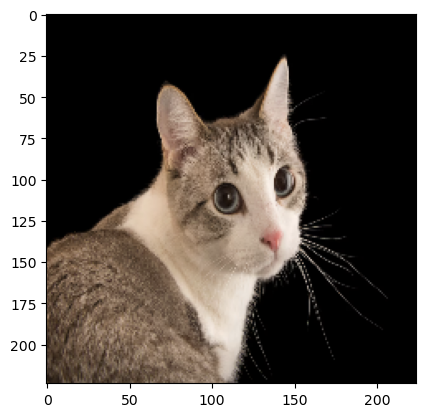

In [33]:
### "img" is used for visualizatoin, only~
print("The shape of img is", img.shape)
plt.imshow(img)

In [34]:
### "processed_image" is used for later analysis, and it has one more dimension
print("The dimension of processed_image is", processed_image.shape)

The dimension of processed_image is (1, 224, 224, 3)


# B. Define a "model_grad" 
with same input, but TWO outputs
 - conv_output_values
 - predictions

In [38]:
model_grad = Model([model.inputs],
                   [model.get_layer('block5_conv3').output, model.output])

# C. Make Prediction
to get TWO outputs
- conv_output_values
- predictions

In [39]:
conv_output_values, predictions = model_grad(processed_image)

### c.1. Now let us study "conv_output_values" ^_^

In [51]:
### It is a EagerTensor
type(conv_output_values)

tensorflow.python.framework.ops.EagerTensor

In [41]:
conv_output_values.shape

TensorShape([1, 14, 14, 512])

### c.2. Now let us study "predictions" ^_^

In [52]:
### It is a EagerTensor
type(predictions)

tensorflow.python.framework.ops.EagerTensor

In [53]:
predictions.shape

TensorShape([1, 2])

In [54]:
predictions[0]

<tf.Tensor: shape=(2,), dtype=float32, numpy=array([0.24743898, 0.75256103], dtype=float32)>

In [55]:
predictions[0, 0]

<tf.Tensor: shape=(), dtype=float32, numpy=0.24743898212909698>

In [56]:
predictions[0, 1]

<tf.Tensor: shape=(), dtype=float32, numpy=0.7525610327720642>

# d. Gradient

In [70]:
with tf.GradientTape() as tape:
    conv_output_values, predictions = model_grad(processed_image)

    # watch the conv_output_values
    tape.watch(conv_output_values)

    ## Use binary cross entropy loss
    ## actual_label is 0 if cat, 1 if dog
    # get prediction probability of dog
    # If model does well,
    # pred_prob should be close to 0 if cat, close to 1 if dog
    pred_prob = predictions[:,1]

    # make sure actual_label is a float, like the rest of the loss calculation
    #actual_label = tf.cast(actual_label, dtype=tf.float32)
    actual_label = 0

    # add a tiny value to avoid log of 0
    smoothing = 0.00001

    #### Calculate loss as binary cross entropy
    loss = -1 * (actual_label * tf.math.log(pred_prob + smoothing) + (1 - actual_label) * tf.math.log(1 - pred_prob + smoothing))
    print(f"binary loss: {loss}")


binary loss: [1.3965509]


In [71]:
# get the gradient of the loss with respect to the outputs of the last conv layer
grads_values = tape.gradient(loss, conv_output_values)

print("The shape is the same as the conv_output_values. ")
grads_values.shape

The shape is the same as the conv_output_values. 


TensorShape([1, 14, 14, 512])

In [72]:
grads_values = K.mean(grads_values, axis=(0,1,2))

grads_values.shape

TensorShape([512])

In [73]:
### change the shape for conv_output_values
conv_output_values = np.squeeze(conv_output_values.numpy())
conv_output_values.shape

(14, 14, 512)

In [74]:
### change the shape of grads_values
grads_values = grads_values.numpy()
grads_values.shape

(512,)

In [94]:
# weight the convolution outputs with the computed gradients
for i in range(512):
    conv_output_values[:,:,i] *= grads_values[i]

conv_output_values.shape

(14, 14, 512)

The shape of the heatmap is (14, 14)


Text(0.5, 1.0, 'This is from get_CAM function.')

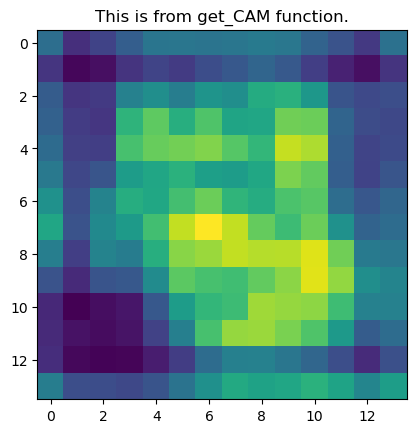

In [95]:
### generate the heatmap

heatmap = np.mean(conv_output_values, axis=-1)

heatmap = np.maximum(heatmap, 0)
heatmap /= heatmap.max()

print("The shape of the heatmap is", heatmap.shape)
plt.imshow(heatmap)
plt.title("This is from get_CAM function.")

The shape of the heatmap_FinalPlot is (224, 224, 3)


Text(0.5, 1.0, 'This is from show_sample function.')

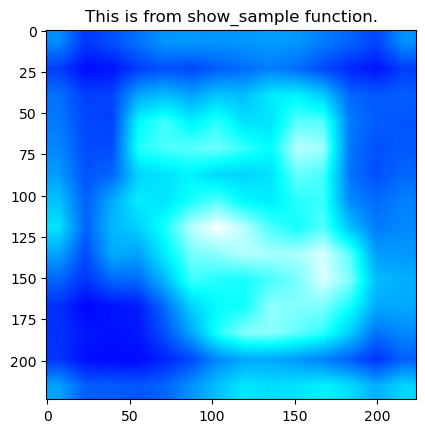

In [98]:
heatmap_FinalPlot = cv2.resize(heatmap, (processed_image.shape[1], processed_image.shape[2]))  ### here, the shape!!!
heatmap_FinalPlot = heatmap_FinalPlot *255
heatmap_FinalPlot = np.clip(heatmap_FinalPlot, 0, 255).astype(np.uint8)
heatmap_FinalPlot = cv2.applyColorMap(heatmap_FinalPlot, cv2.COLORMAP_HOT)

print("The shape of the heatmap_FinalPlot is", heatmap_FinalPlot.shape)
plt.imshow(heatmap_FinalPlot)
plt.title("This is from show_sample function.")

# ==============================================
This is the end of the `dissection` of the big function(s) below.
# ==============================================

In [99]:
def get_CAM(processed_image, actual_label, layer_name='block5_conv3'):
    model_grad = Model([model.inputs],
                       [model.get_layer(layer_name).output, model.output])

    with tf.GradientTape() as tape:
        conv_output_values, predictions = model_grad(processed_image)

        # watch the conv_output_values
        tape.watch(conv_output_values)

        ## Use binary cross entropy loss
        ## actual_label is 0 if cat, 1 if dog
        # get prediction probability of dog
        # If model does well,
        # pred_prob should be close to 0 if cat, close to 1 if dog
        pred_prob = predictions[:,1]

        # make sure actual_label is a float, like the rest of the loss calculation
        actual_label = tf.cast(actual_label, dtype=tf.float32)

        # add a tiny value to avoid log of 0
        smoothing = 0.00001

        #### Calculate loss as binary cross entropy
        loss = -1 * (actual_label * tf.math.log(pred_prob + smoothing) + (1 - actual_label) * tf.math.log(1 - pred_prob + smoothing))
        print(f"binary loss: {loss}")

    # get the gradient of the loss with respect to the outputs of the last conv layer
    grads_values = tape.gradient(loss, conv_output_values)
    grads_values = K.mean(grads_values, axis=(0,1,2))

    ### change the shape for conv_output_values
    conv_output_values = np.squeeze(conv_output_values.numpy())
    ### change the shape of grads_values
    grads_values = grads_values.numpy()

    # weight the convolution outputs with the computed gradients
    for i in range(512):
        conv_output_values[:,:,i] *= grads_values[i]
        
    ### generate the heatmap
    heatmap = np.mean(conv_output_values, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= heatmap.max()

    del model_grad, conv_output_values, grads_values, loss
    
    return heatmap

In [100]:
def show_sample(idx=None):

    # if image index is specified, get that image
    if idx:
        for img, label in test_batches.take(idx):
            sample_image = img[0]
            sample_label = label[0]
    # otherwise if idx is not specified, get a random image
    else:
        for img, label in test_batches.shuffle(1000).take(1):
            sample_image = img[0]
            sample_label = label[0]

    sample_image_processed = np.expand_dims(sample_image, axis=0)

    activations = vis_model.predict(sample_image_processed)

    pred_label = np.argmax(model.predict(sample_image_processed), axis=-1)[0]

    sample_activation = activations[0][0,:,:,16]

    sample_activation-=sample_activation.mean()
    sample_activation/=sample_activation.std()

    sample_activation *=255
    sample_activation = np.clip(sample_activation, 0, 255).astype(np.uint8)

    heatmap = get_CAM(sample_image_processed, sample_label)
    heatmap = cv2.resize(heatmap, (sample_image.shape[0], sample_image.shape[1]))
    heatmap = heatmap *255
    heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_HOT)
    converted_img = sample_image.numpy()
    super_imposed_image = cv2.addWeighted(converted_img, 0.8, heatmap.astype('float32'), 2e-3, 0.0)

    f,ax = plt.subplots(2,2, figsize=(15,8))

    ax[0,0].imshow(sample_image)
    ax[0,0].set_title(f"True label: {sample_label} \n Predicted label: {pred_label}")
    ax[0,0].axis('off')

    ax[0,1].imshow(sample_activation)
    ax[0,1].set_title("Random feature map")
    ax[0,1].axis('off')

    ax[1,0].imshow(heatmap)
    ax[1,0].set_title("Class Activation Map")
    ax[1,0].axis('off')

    ax[1,1].imshow(super_imposed_image)
    ax[1,1].set_title("Activation map superimposed")
    ax[1,1].axis('off')
    plt.tight_layout()
    plt.show()

    return activations

### 3.2 Time to visualize the results

In [ ]:
# load the weights trained on Colab
model.load_weights('weights_trained_on_colab.weights.h5')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


Corrupt JPEG data: 1403 extraneous bytes before marker 0xd9


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
binary loss: [1.6288593]


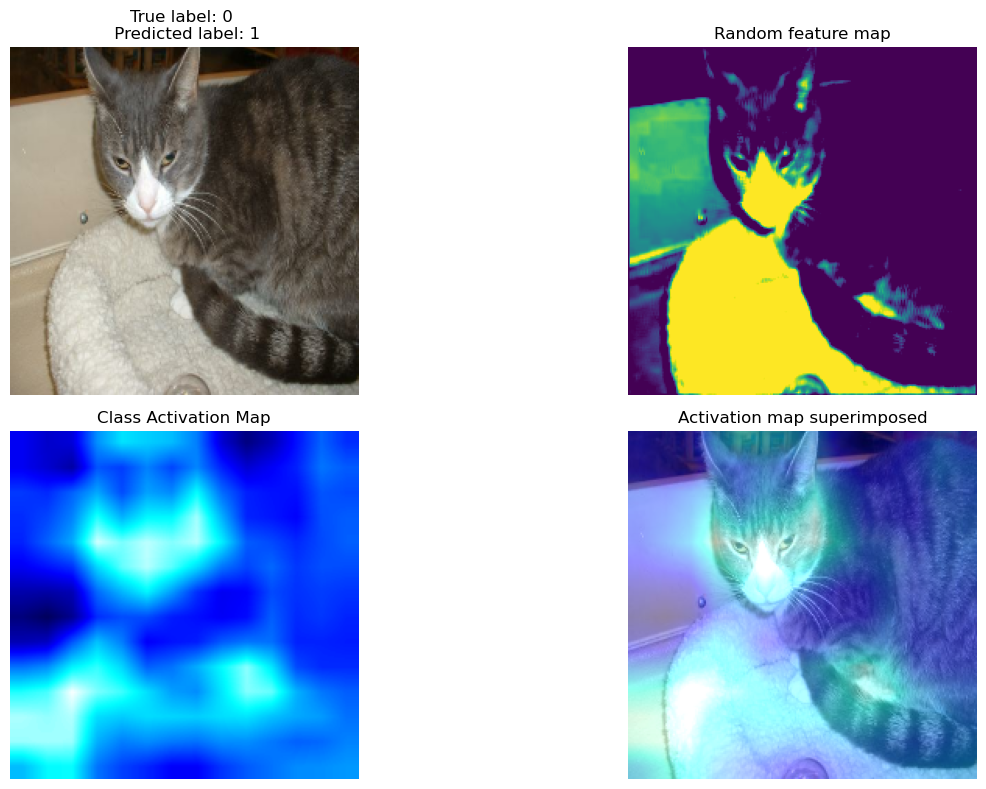

In [104]:
# Choose an image index to show, or leave it as None to get a random image
activations = show_sample(idx=None)    ###(idx=100)    #####

### 3.3 Intermediate activations of layers

You can use the utility function below to visualize the activations in the intermediate layers you defined earlier. This plots the feature side by side for each convolution layer starting from the earliest layer all the way to the final convolution layer.

In [107]:
def visualize_intermediate_activations(layer_names, activations):
    assert len(layer_names)==len(activations), "Make sure layers and activation values match"
    images_per_row=16

    for layer_name, layer_activation in zip(layer_names, activations):
        nb_features = layer_activation.shape[-1]
        size= layer_activation.shape[1]

        nb_cols = nb_features // images_per_row
        grid = np.zeros((size*nb_cols, size*images_per_row))

        for col in range(nb_cols):
            for row in range(images_per_row):
                feature_map = layer_activation[0,:,:,col*images_per_row + row]
                feature_map -= feature_map.mean()
                feature_map /= feature_map.std()
                feature_map *=255
                feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)

                grid[col*size:(col+1)*size, row*size:(row+1)*size] = feature_map

        scale = 1./size
        plt.figure(figsize=(scale*grid.shape[1], scale*grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.axis('off')
        plt.imshow(grid, aspect='auto', cmap='viridis')
    plt.show()

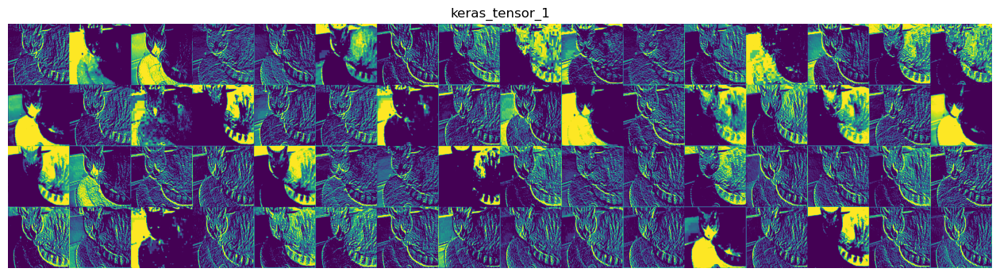

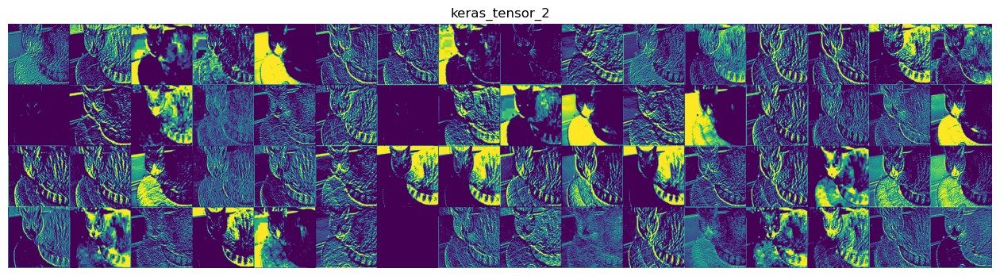

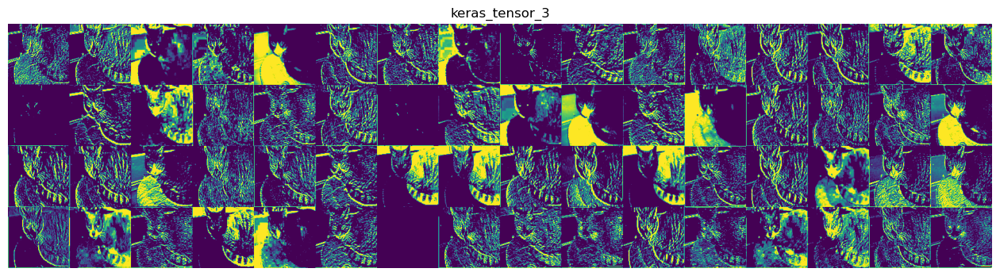

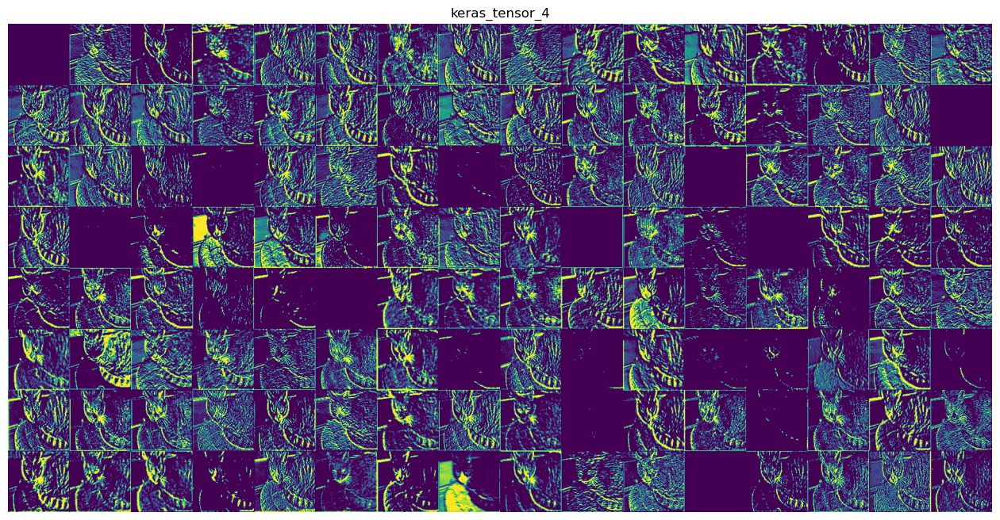

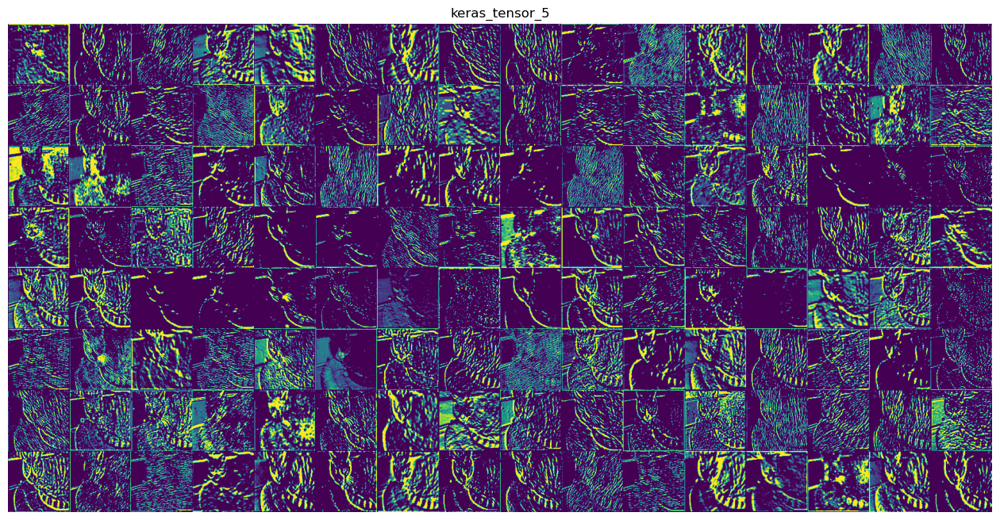

...

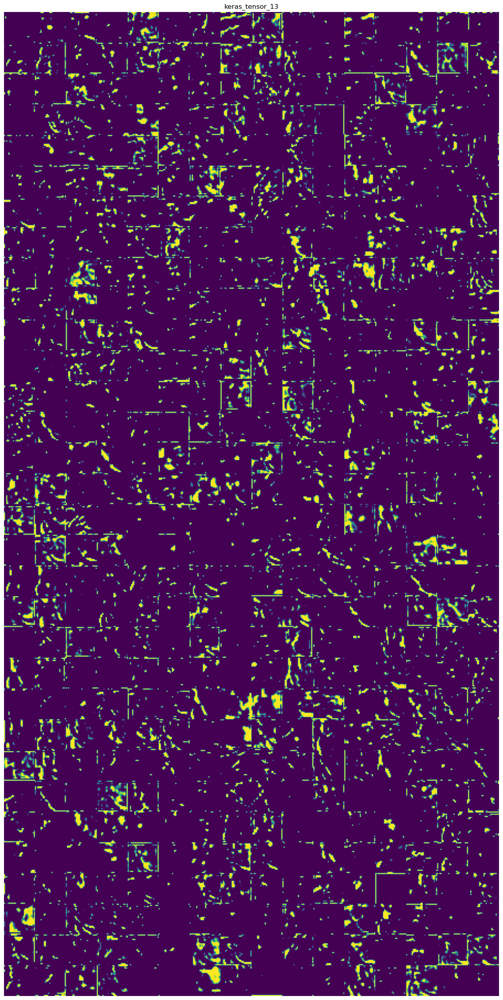

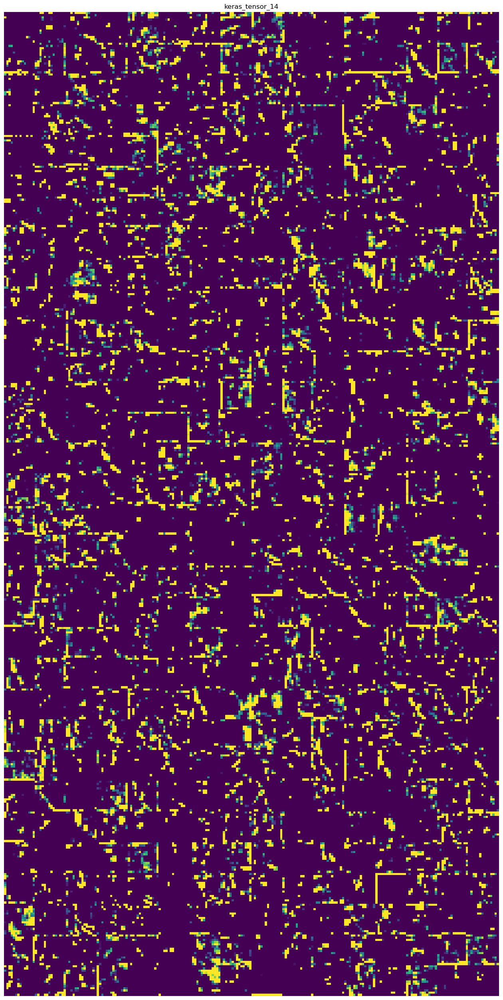

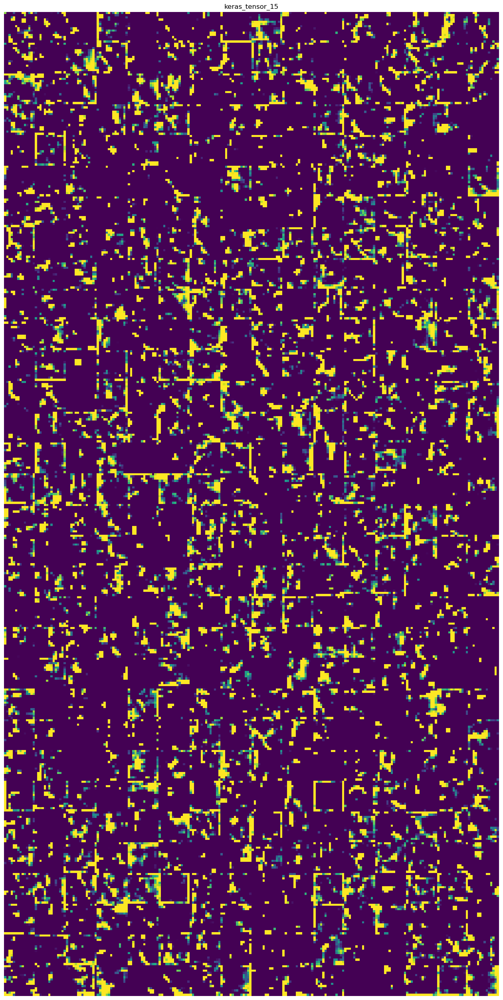

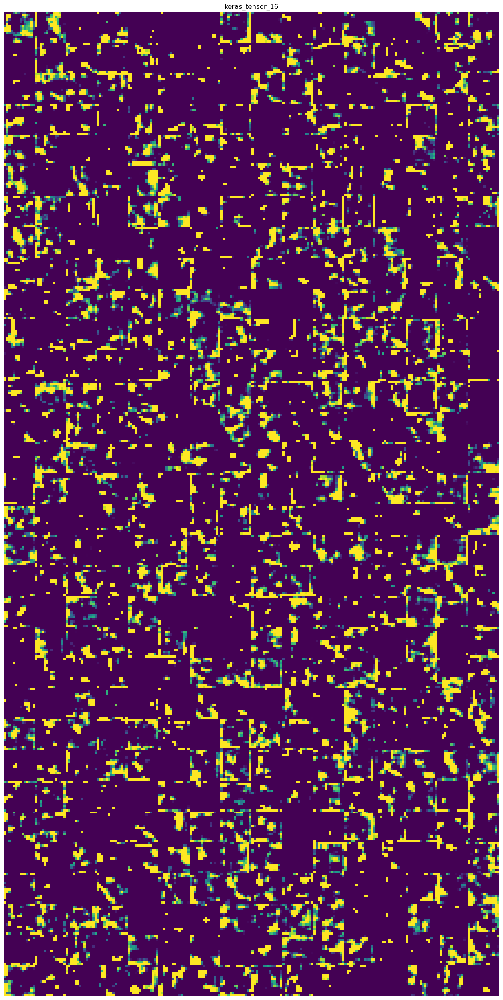

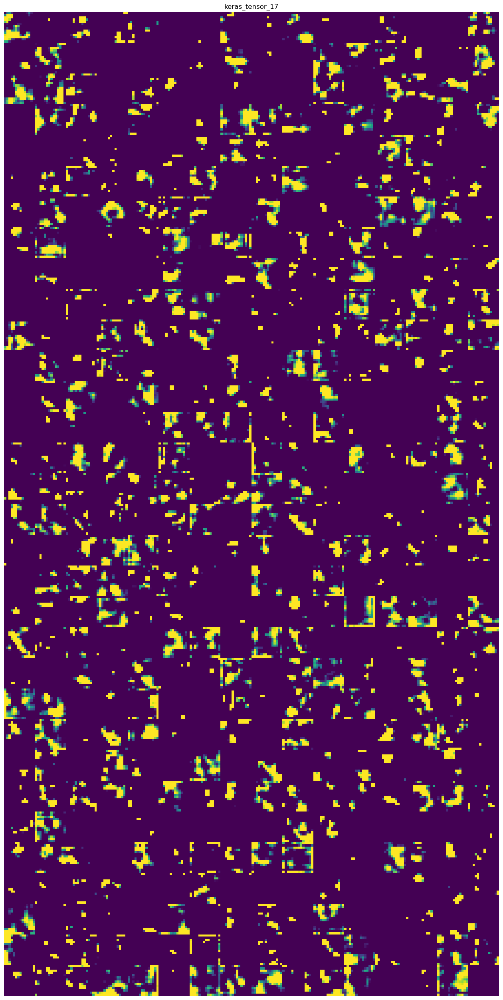

In [108]:
visualize_intermediate_activations(activations=activations,
                                   layer_names=layer_names)

In [11]:
conv_output_values

NameError: name 'conv_output_values' is not defined

In [12]:
loss

NameError: name 'loss' is not defined

If you scroll all the way down to see the outputs of the final conv layer, you'll see that there are very few active features and these are mostly located in the face of the cat. This is the region of the image that your model looks at when determining the class.